In [7]:
import tensorflow as tf
import cv2
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Conv2D, Dropout, MaxPooling2D, Dense, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback
from tensorflow.keras.optimizers import SGD
import matplotlib.pyplot as plt
import os
import numpy as np
from sklearn.metrics import confusion_matrix
import pickle
import math
from utils import GradCamHeatMapper, image_count

In [8]:
height = 1080
width = 1920
channels = 3
scale_factor = 0.2
scaled_height = int(height * scale_factor)
scaled_width = int(width * scale_factor)
input_shape = (scaled_height, scaled_width, channels)
batch_size = 16
epochs = 50
training_dir = 'data/training/'
validation_dir = 'data/validation/'

num_training_samples = image_count(training_dir + 'train/') + image_count(training_dir + 'no_train/')
num_validation_samples = image_count(validation_dir + 'train/') + image_count(validation_dir + 'no_train/')

print("Scaled height: {}".format(scaled_height))
print("Scaled width: {}".format(scaled_width))
print("Input shape: {}".format(input_shape))
print("Batch size: {}".format(batch_size))
print("# epochs: {}".format(epochs))
print("# training samples: {}".format(num_training_samples))
print("# validation samples: {}".format(num_validation_samples))

Scaled height: 216
Scaled width: 384
Input shape: (216, 384, 3)
Batch size: 16
# epochs: 50
# training samples: 7491
# validation samples: 1251


In [9]:
def create_model():
    model = Sequential()
    model.add(Conv2D(32, (3, 3), input_shape=input_shape, activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.2))

    model.add(Conv2D(32, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.2))

    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.2))

    model.add(Flatten())
    model.add(Dense(64, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(loss='binary_crossentropy',
                  optimizer=SGD(lr=1e-4, momentum=0.9),
                  metrics=['accuracy'])
    
    return model

# Instantiate the model
model = create_model()
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 214, 382, 32)      896       
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 107, 191, 32)      0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 107, 191, 32)      0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 105, 189, 32)      9248      
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 52, 94, 32)        0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 52, 94, 32)        0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 50, 92, 64)       

In [10]:
# Set up training and validation data
training_datagen = ImageDataGenerator(rescale  =  1./255)

validation_datagen = ImageDataGenerator(rescale = 1./255)

training_generator = training_datagen.flow_from_directory(
        'data/training/',
        target_size=(scaled_height, scaled_width),
        batch_size=batch_size,
        class_mode='binary',
        shuffle=True)

validation_generator = validation_datagen.flow_from_directory(
        'data/validation/',
        target_size=(scaled_height, scaled_width),
        batch_size=batch_size,
        class_mode='binary',
        shuffle=False)

Found 7491 images belonging to 2 classes.
Found 1251 images belonging to 2 classes.


In [11]:
class HistoryRecorder(Callback):
    def on_train_begin(self, logs={}):
        self.loss = []
        self.accuracy = []
        self.val_loss = [] 
        self.val_accuracy = []

    def on_epoch_end(self, epoch, logs={}):
        self.loss.append(logs.get('loss'))
        self.accuracy.append(logs.get('accuracy'))
        self.val_loss.append(logs.get('val_loss'))
        self.val_accuracy.append(logs.get('val_accuracy'))
    
    def as_dict(self):
        return {'loss': self.loss, 'accuracy': self.accuracy, 'val_loss': self.val_loss, 'val_accuracy': self.val_accuracy}
        
class BestEpochRecorder(Callback):
    def on_train_begin(self, logs={}):
        self.started = False
        self.best_val_loss = 0.0
        self.best_epoch = 1
    
    def on_epoch_end(self, epoch, logs={}):
        epoch_val_loss = logs.get('val_loss')
        if epoch_val_loss < self.best_val_loss or not self.started:
            self.started = True
            self.best_val_loss = epoch_val_loss
            self.best_epoch = epoch
    
    def as_dict(self):
        return {'started': self.started, 'best_val_loss': self.best_val_loss, 'best_epoch': self.best_epoch}

history_recorder = HistoryRecorder()
best_epoch_recorder = BestEpochRecorder()
callbacks = [EarlyStopping(monitor = 'val_loss', patience = 3, restore_best_weights = True),
             ModelCheckpoint(filepath = 'train_detection_cnn', monitor = 'val_loss', save_best_only = True),
             history_recorder,
             best_epoch_recorder]

In [12]:
# Train the model over several epochs and save the results from the best epoch
model.fit_generator(
    training_generator,
    steps_per_epoch = math.ceil(num_training_samples / batch_size),
    epochs = epochs,
    callbacks = callbacks,
    validation_data = validation_generator,
    validation_steps = math.ceil(num_validation_samples / batch_size)
)

Epoch 1/50
469/469 [==============================] - 396s 845ms/step - loss: 0.5290 - accuracy: 0.7805 - val_loss: 0.4123 - val_accuracy: 0.8313
Epoch 2/50
469/469 [==============================] - 410s 875ms/step - loss: 0.3809 - accuracy: 0.8513 - val_loss: 0.3070 - val_accuracy: 0.8905
Epoch 3/50
231/469 [=============>................] - ETA: 2:45 - loss: 0.3200 - accuracy: 0.8850

KeyboardInterrupt: 

In [115]:
# Save the training history and best epoch stats (the epoch index and its associated val loss)
print("Best epoch: {}".format(best_epoch_recorder.best_epoch))
print("Val loss: {}".format(best_epoch_recorder.best_val_loss))

actual_epochs = len(history_recorder.loss)
print("Actual # epochs: {}".format(actual_epochs))

history_dict        = history_recorder.as_dict()
best_epoch_dict     = best_epoch_recorder.as_dict()
history_filename    = 'history.p'
best_epoch_filename = 'best_epoch.p'
history_file        = open(history_filename, 'wb')
best_epoch_file     = open(best_epoch_filename, 'wb')
pickle.dump(history_dict, history_file)
pickle.dump(best_epoch_dict, best_epoch_file)
history_file.close()
best_epoch_file.close()

Best epoch: 14
Val loss: 0.08188955586929107
Actual # epochs: 18


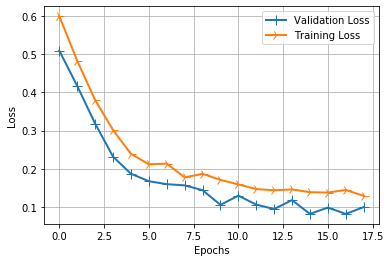

In [120]:
# Plot loss curves
epochs_array = np.arange(actual_epochs)
loss_values = history_recorder.loss
val_loss_values = history_recorder.val_loss
line1 = plt.plot(epochs_array, val_loss_values, label='Validation Loss')
line2 = plt.plot(epochs_array, loss_values, label='Training Loss')
plt.setp(line1, linewidth = 2.0, marker = '+', markersize = 10.0)
plt.setp(line2, linewidth = 2.0, marker = '4', markersize = 10.0)
plt.xlabel('Epochs') 
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

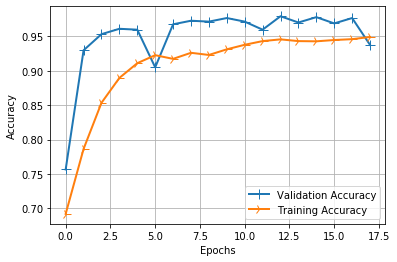

In [121]:
# Plot accuracy curves
acc_values = history_recorder.accuracy
val_acc_values = history_recorder.val_accuracy
line1 = plt.plot(epochs_array, val_acc_values, label='Validation Accuracy')
line2 = plt.plot(epochs_array, acc_values, label='Training Accuracy')
plt.setp(line1, linewidth = 2.0, marker = '+', markersize = 10.0)
plt.setp(line2, linewidth = 2.0, marker = '4', markersize = 10.0)
plt.xlabel('Epochs') 
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()
plt.show()

In [5]:
y_true = validation_generator.classes
y_pred = model.predict_generator(validation_generator).flatten()
class_idx_dict = validation_generator.class_indices
print('Class index for \'no_train\' is {}.'.format(class_idx_dict['no_train']))
print('Class index for \'train\' is {}.'.format(class_idx_dict['train']))

Class index for 'no_train' is 0.
Class index for 'train' is 1.


Model said no_train/mnp-20191116_210044_0303-0033.jpg contained a train (0.521477460861206), but it didn't:


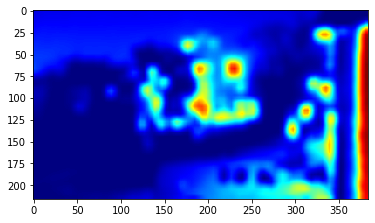

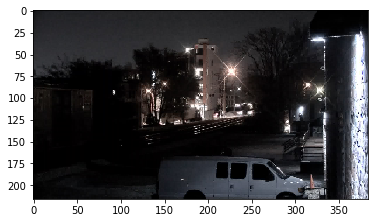

Model said train/mdp-20191116_095827_31F4-0007.jpg did not contain a train (0.29361897706985474), but it did:


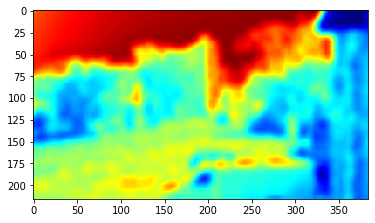

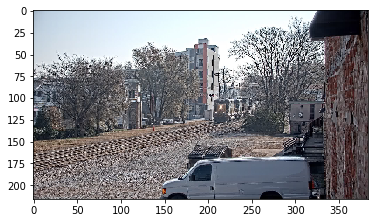

Model said train/mdp-20191116_095827_31F4-0008.jpg did not contain a train (0.3122674226760864), but it did:


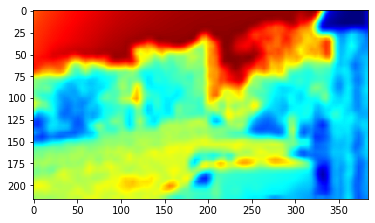

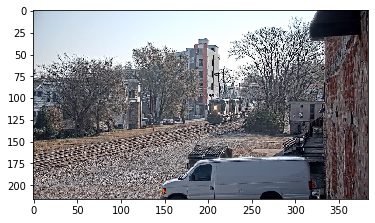

Model said train/mdp-20191116_095827_31F4-0009.jpg did not contain a train (0.33208024501800537), but it did:


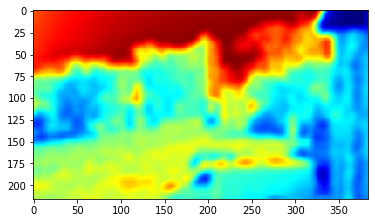

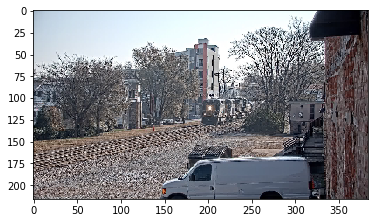

Model said train/mdp-20191116_095827_31F4-0013.jpg did not contain a train (0.3259844183921814), but it did:


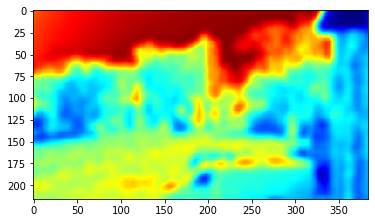

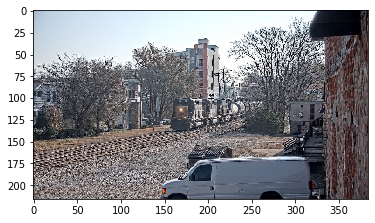

Model said train/mdp-20191116_095827_31F4-0040.jpg did not contain a train (0.39358124136924744), but it did:


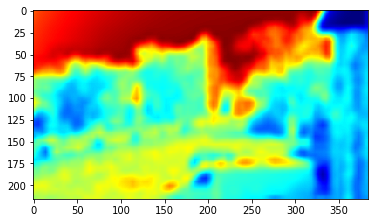

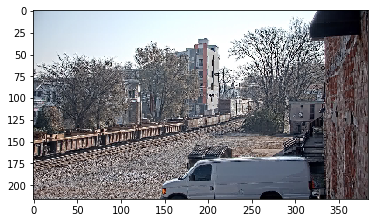

Model said train/mdp-20191116_095827_31F4-0041.jpg did not contain a train (0.41696369647979736), but it did:


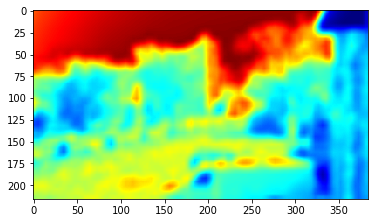

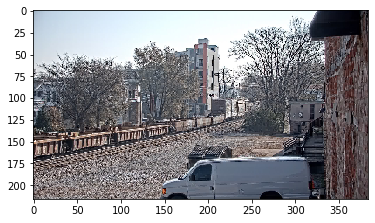

Model said train/mdp-20191116_095827_31F4-0045.jpg did not contain a train (0.2929399013519287), but it did:


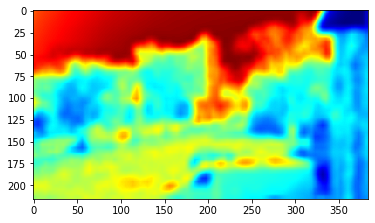

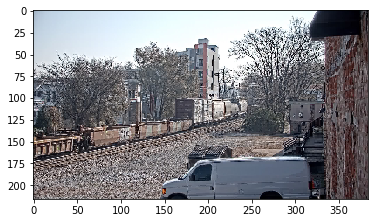

Model said train/mdp-20191116_111507_B5E6-0101.jpg did not contain a train (0.24510511755943298), but it did:


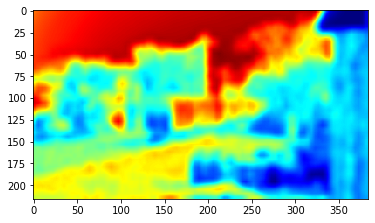

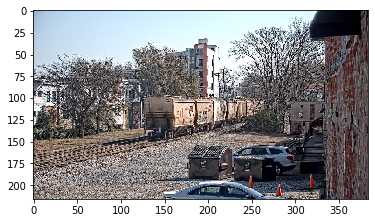

Model said train/mdp-20191116_122653_D272-0036.jpg did not contain a train (0.22710451483726501), but it did:


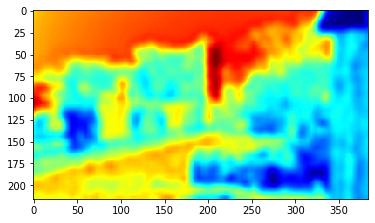

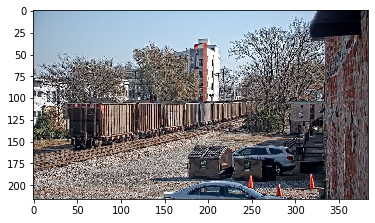

Model said train/mdp-20191116_122653_D272-0041.jpg did not contain a train (0.2768417000770569), but it did:


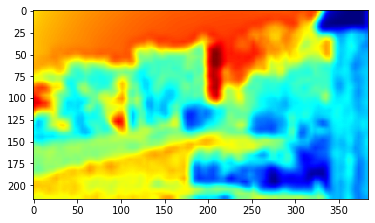

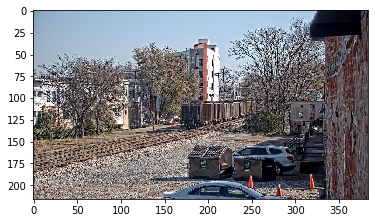

Model said train/mdp-20191116_141948_B423-0008.jpg did not contain a train (0.24012267589569092), but it did:


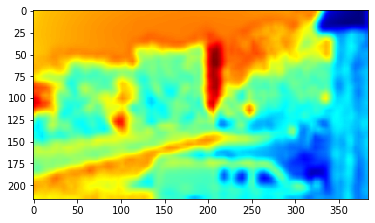

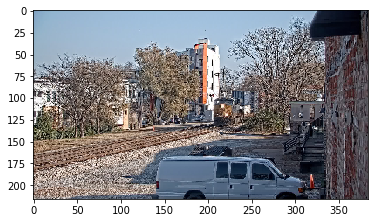

Model said train/mdp-20191116_151621_C0EE-0055.jpg did not contain a train (0.45786166191101074), but it did:


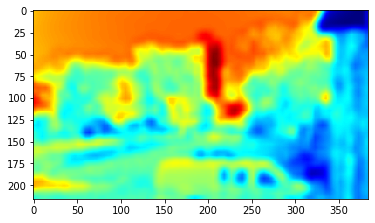

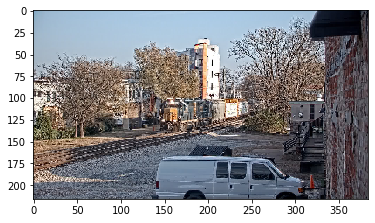

Model said train/mdp-20191116_151621_C0EE-0056.jpg did not contain a train (0.3581005930900574), but it did:


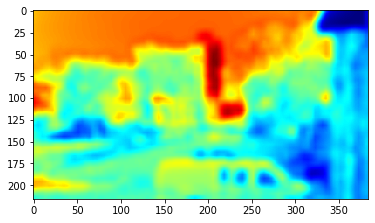

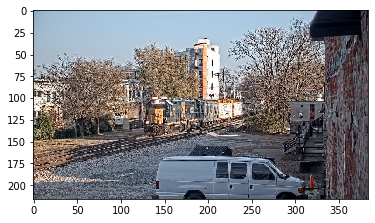

Model said train/mnp-20191116_021630_619C-0008.jpg did not contain a train (0.1386646032333374), but it did:


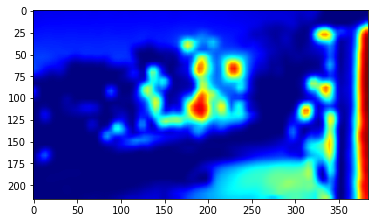

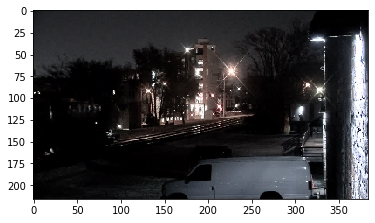

Model said train/mnp-20191116_205714_77D3-0009.jpg did not contain a train (0.14868071675300598), but it did:


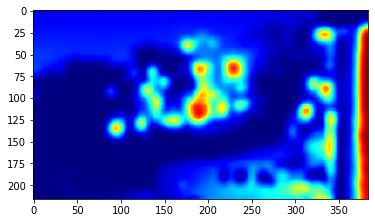

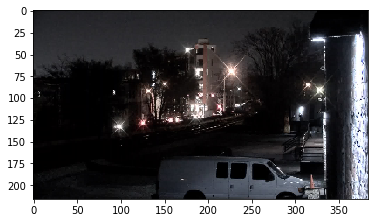

Model said train/wdx-20191118_080011_9E16-0062.jpg did not contain a train (0.4777941107749939), but it did:


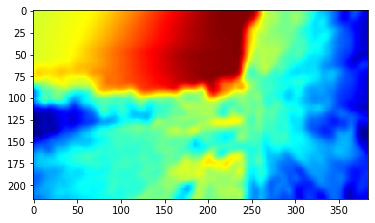

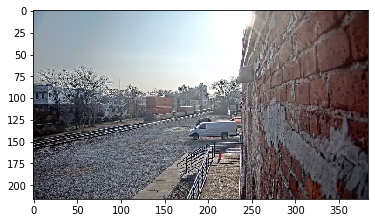

Misclassified 17 images.


In [28]:
# Round to nearest class label (1 "train" or 0 "no_train")
pred_class_idxs = np.around(y_pred)
filenames = validation_generator.filenames
miss_count = 0
grad_cam_heat_mapper = GradCamHeatMapper('train_detection_cnn')
for i in range(num_validation_samples):
    if int(pred_class_idxs[i]) != y_true[i]:
        miss_count += 1
        if y_true[i] == class_idx_dict['no_train']:
            print('Model said {} contained a train ({}), but it didn\'t:'.format(filenames[i], y_pred[i]))
        else:
            print('Model said {} did not contain a train ({}), but it did:'.format(filenames[i], y_pred[i]))
        batch_number = i // batch_size
        img_number = i % batch_size
        img = validation_generator[batch_number][0][img_number]
        img_heatmap = grad_cam_heat_mapper.get_heat_map(img)
        plt.imshow(img_heatmap)
        plt.show()
        plt.imshow(img)
        plt.show()

print('Misclassified {} images.'.format(miss_count))


In [62]:
cm = confusion_matrix(y_true, pred_class_idxs)
print('Confusion Matrix:')
print(cm)
true_negatives = cm[0][0]
false_negatives = cm[1][0]
true_positives = cm[1][1]
false_positives = cm[0][1]
print('True negatives: {}'.format(true_negatives))
print('False negatives: {}'.format(false_negatives))
print('True positives: {}'.format(true_positives))
print('False positives: {}'.format(false_positives))

Confusion Matrix:
[[190   0]
 [ 14 545]]
True negatives: 190
False negatives: 14
True positives: 545
False positives: 0


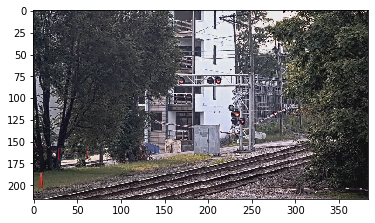

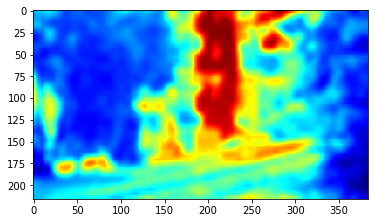

In [35]:
from keras.preprocessing.image import load_img, img_to_array

img = load_img("data/training/no_train/coming000010.jpg",target_size=(scaled_height, scaled_width))
img_array = img_to_array(img, dtype='float32')
img_array_rescaled = img_array / 255
img_array_rescaled = np.expand_dims(img_array_rescaled, axis=0)
plt.imshow(img_array_rescaled[0])
plt.show()
model.predict(img_array_rescaled)

img_heatmap = grad_cam_heat_mapper.get_heat_map(img_array_rescaled[0])
plt.imshow(img_heatmap)
plt.show()

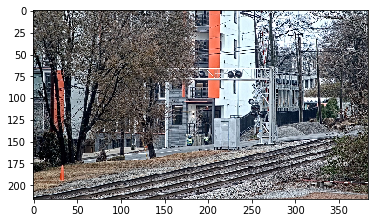

[0.9964497]


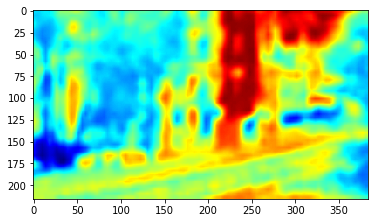

In [37]:
img = load_img("test.jpg",target_size=(scaled_height, scaled_width))
img_array = img_to_array(img, dtype='float32')
img_array_rescaled = img_array / 255
img_array_rescaled = np.expand_dims(img_array_rescaled, axis=0)
plt.imshow(img_array_rescaled[0])
plt.show()
preds = model.predict(img_array_rescaled)
print(preds[0])

img_heatmap = grad_cam_heat_mapper.get_heat_map(img_array_rescaled[0])
plt.imshow(img_heatmap)
plt.show()

Found 184 images belonging to 2 classes.
Model said no_train/wdx-20191118_080011_9E16-0001.jpg contained a train (0.822270393371582), but it didn't:


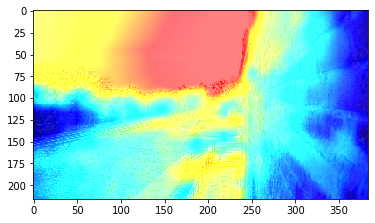

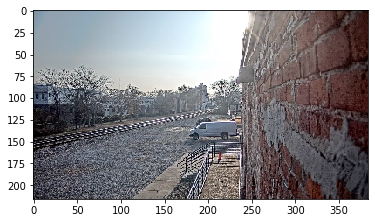

Model said no_train/wdx-20191118_080011_9E16-0002.jpg contained a train (0.8240889310836792), but it didn't:


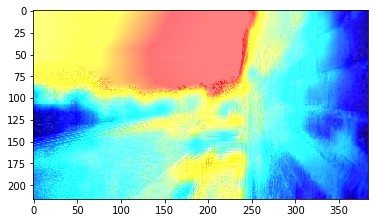

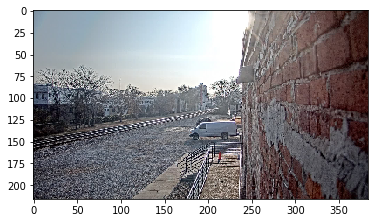

Model said no_train/wdx-20191118_080011_9E16-0003.jpg contained a train (0.8200488090515137), but it didn't:


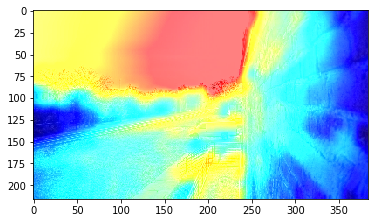

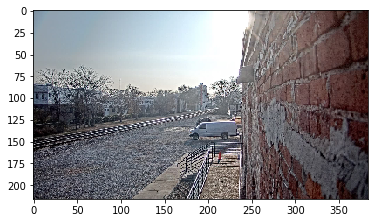

Model said no_train/wdx-20191118_080011_9E16-0004.jpg contained a train (0.8186628222465515), but it didn't:


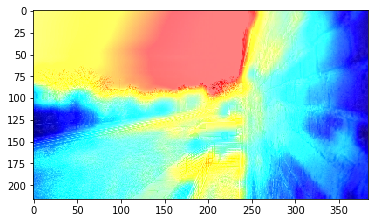

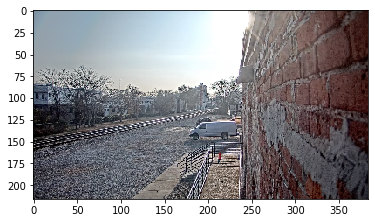

Model said no_train/wdx-20191118_080011_9E16-0005.jpg contained a train (0.8245396614074707), but it didn't:


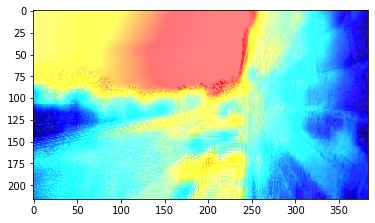

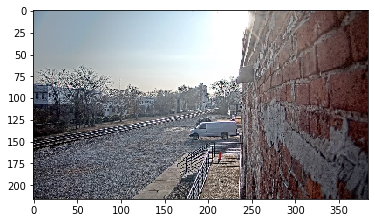

Model said no_train/wdx-20191118_080011_9E16-0006.jpg contained a train (0.8188445568084717), but it didn't:


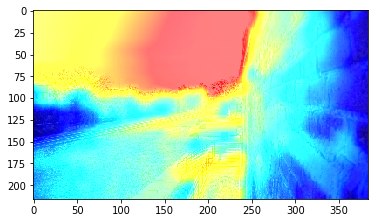

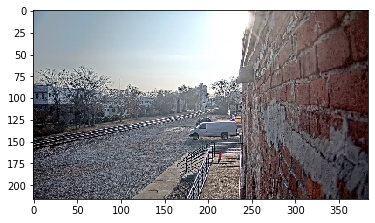

Model said no_train/wdx-20191118_080011_9E16-0007.jpg contained a train (0.8200080990791321), but it didn't:


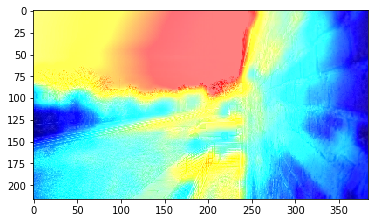

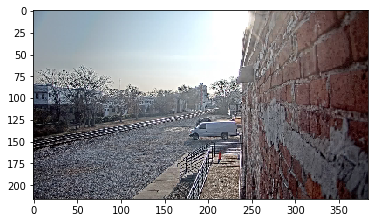

Model said no_train/wdx-20191118_080011_9E16-0008.jpg contained a train (0.84979248046875), but it didn't:


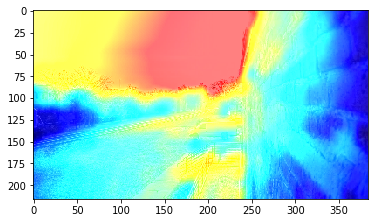

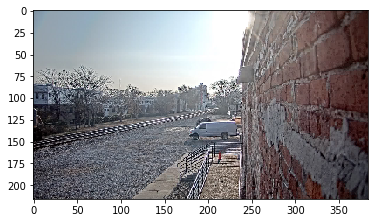

Model said no_train/wdx-20191118_081917_A30E-0001.jpg contained a train (0.8365843296051025), but it didn't:


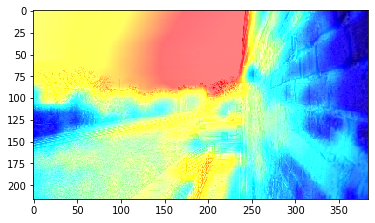

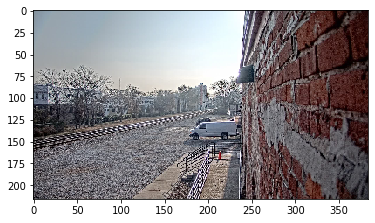

Model said no_train/wdx-20191118_081917_A30E-0002.jpg contained a train (0.8414241075515747), but it didn't:


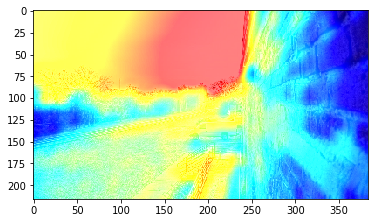

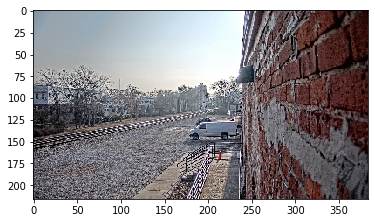

Model said no_train/wdx-20191118_081917_A30E-0003.jpg contained a train (0.8354074358940125), but it didn't:


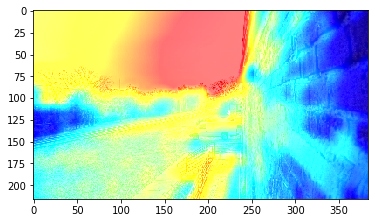

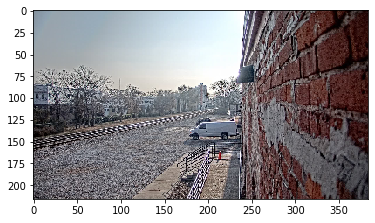

Model said no_train/wdx-20191118_081917_A30E-0004.jpg contained a train (0.8411480188369751), but it didn't:


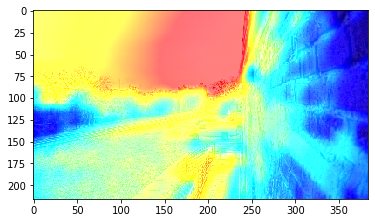

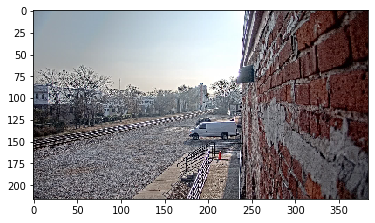

Model said no_train/wdx-20191118_081917_A30E-0005.jpg contained a train (0.8414751291275024), but it didn't:


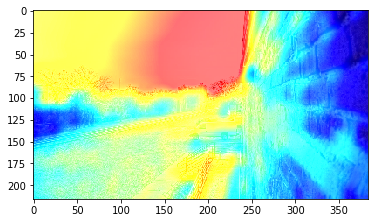

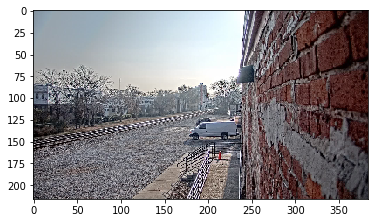

Model said no_train/wdx-20191118_081917_A30E-0006.jpg contained a train (0.8384344577789307), but it didn't:


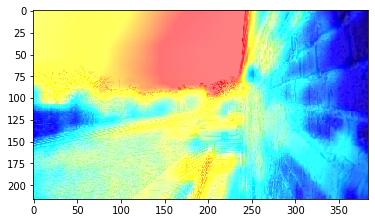

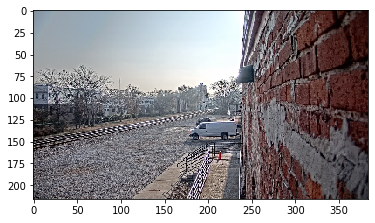

Model said no_train/wdx-20191118_081917_A30E-0007.jpg contained a train (0.8374959230422974), but it didn't:


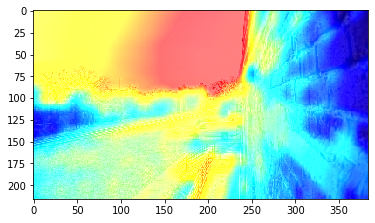

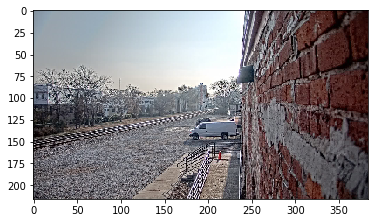

Model said no_train/wdx-20191118_081917_A30E-0008.jpg contained a train (0.871888279914856), but it didn't:


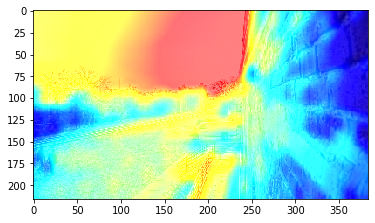

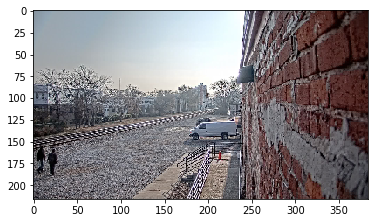

Model said no_train/wdx-20191118_081917_A30E-0009.jpg contained a train (0.8554365634918213), but it didn't:


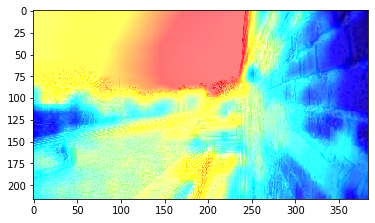

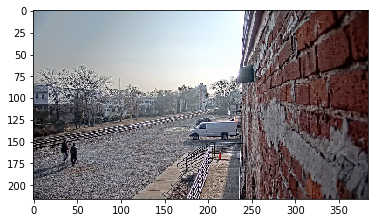

Model said no_train/wdx-20191118_081917_A30E-0010.jpg contained a train (0.8406693935394287), but it didn't:


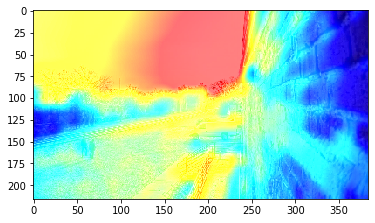

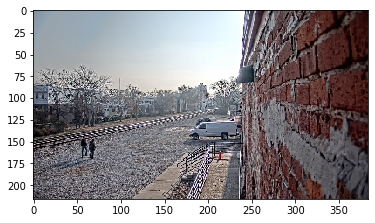

Model said no_train/wdx-20191118_081917_A30E-0011.jpg contained a train (0.8350285291671753), but it didn't:


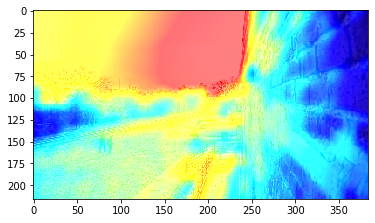

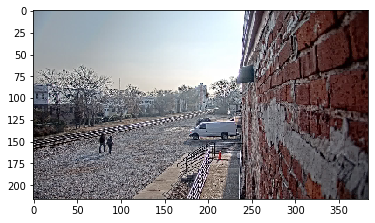

Model said no_train/wdx-20191118_081917_A30E-0012.jpg contained a train (0.8333253860473633), but it didn't:


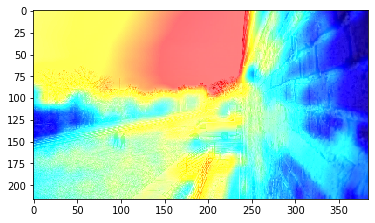

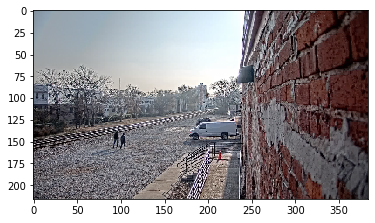

Model said no_train/wdx-20191118_081917_A30E-0013.jpg contained a train (0.8417371511459351), but it didn't:


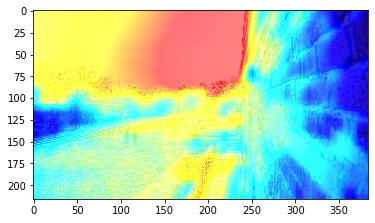

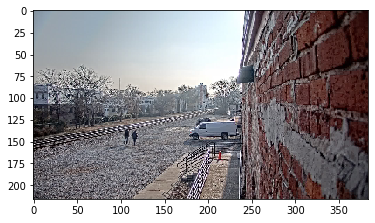

Model said no_train/wdx-20191118_081917_A30E-0014.jpg contained a train (0.8275737762451172), but it didn't:


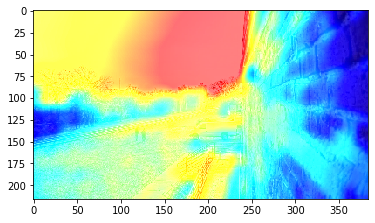

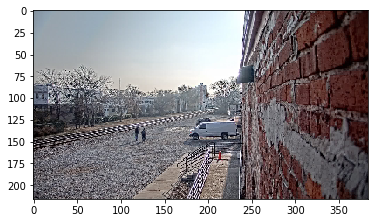

Model said train/wnx-20191118_044632_6AAA-0001.jpg did not contain a train (0.16587847471237183), but it did:


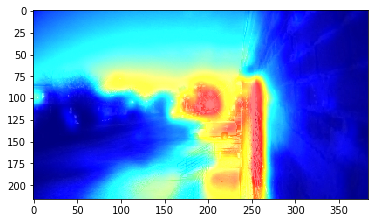

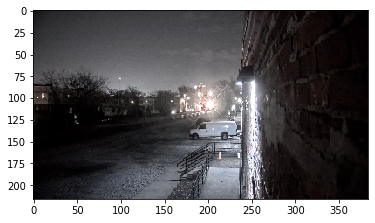

Model said train/wnx-20191118_044632_6AAA-0002.jpg did not contain a train (0.17216801643371582), but it did:


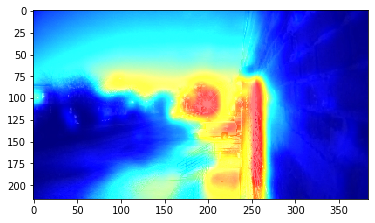

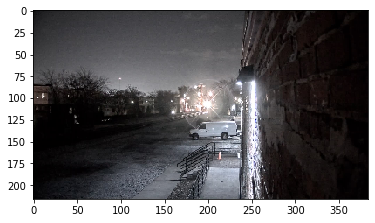

Model said train/wnx-20191118_044632_6AAA-0003.jpg did not contain a train (0.1768992841243744), but it did:


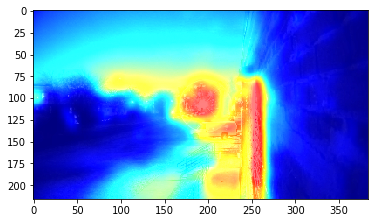

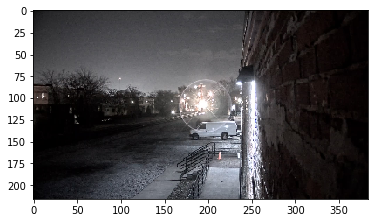

Model said train/wnx-20191118_044632_6AAA-0004.jpg did not contain a train (0.1860319972038269), but it did:


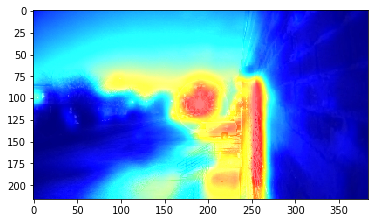

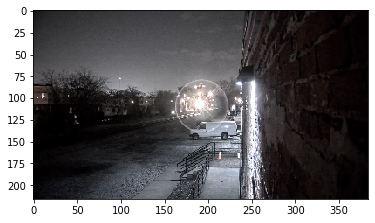

Model said train/wnx-20191118_044632_6AAA-0005.jpg did not contain a train (0.23263007402420044), but it did:


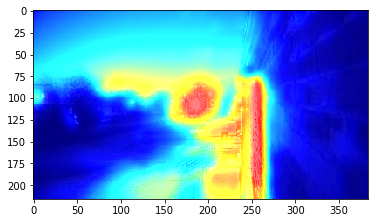

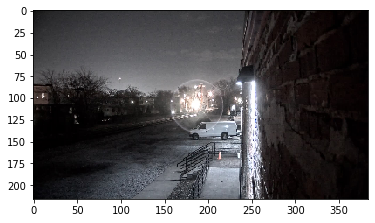

Model said train/wnx-20191118_044632_6AAA-0006.jpg did not contain a train (0.32842177152633667), but it did:


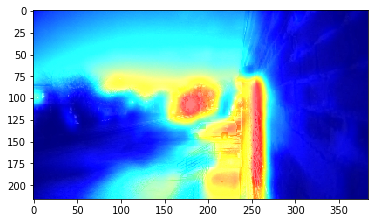

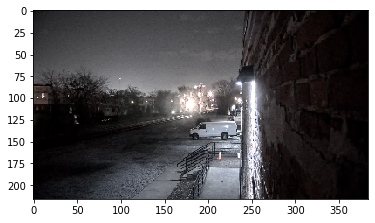

Model said train/wnx-20191118_044632_6AAA-0007.jpg did not contain a train (0.4212985634803772), but it did:


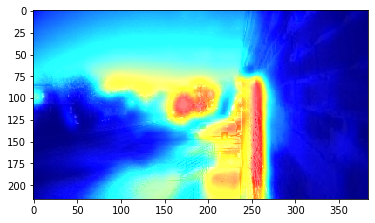

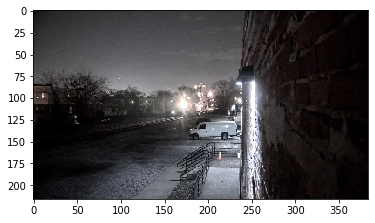

Model said train/wnx-20191118_044632_6AAA-0008.jpg did not contain a train (0.48125651478767395), but it did:


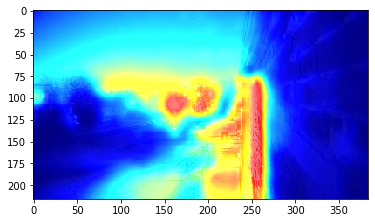

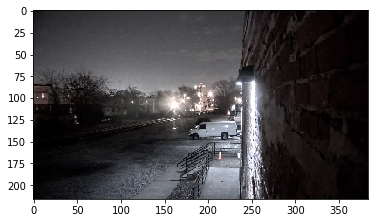

Model said train/wnx-20191118_044632_6AAA-0011.jpg did not contain a train (0.339486300945282), but it did:


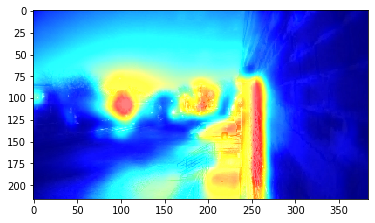

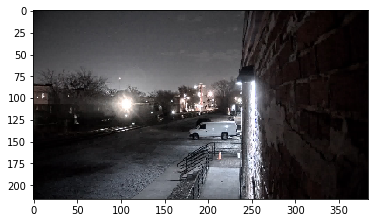

Model said train/wnx-20191118_044632_6AAA-0013.jpg did not contain a train (0.1487298607826233), but it did:


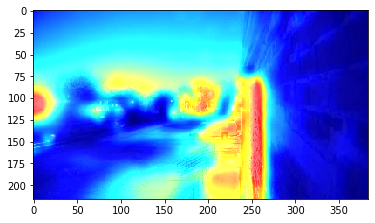

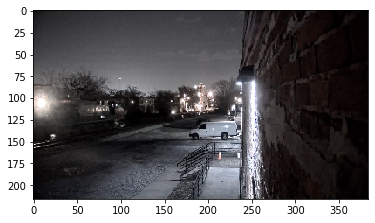

Model said train/wnx-20191118_044632_6AAA-0014.jpg did not contain a train (0.25995171070098877), but it did:


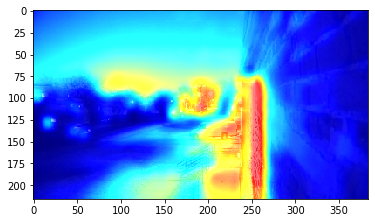

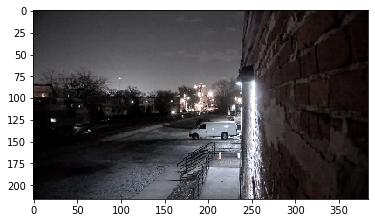

Model said train/wnx-20191118_201031_F7D8-0011.jpg did not contain a train (0.46071112155914307), but it did:


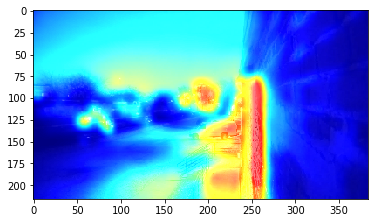

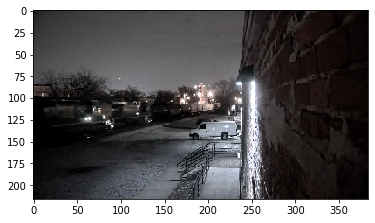

Model said train/wnx-20191118_201031_F7D8-0012.jpg did not contain a train (0.19085660576820374), but it did:


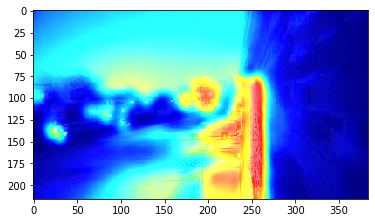

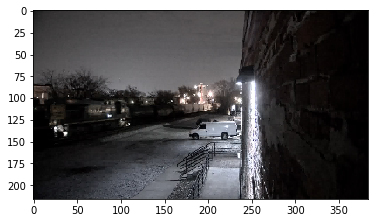

Model said train/wnx-20191118_201031_F7D8-0013.jpg did not contain a train (0.24227401614189148), but it did:


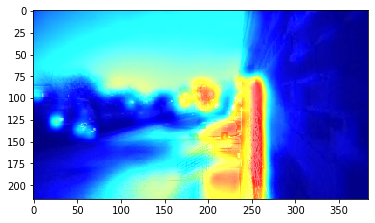

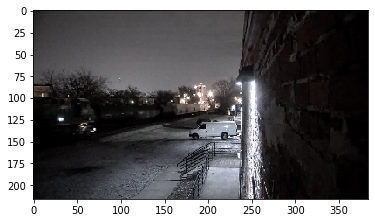

Model said train/wnx-20191118_201031_F7D8-0014.jpg did not contain a train (0.13296610116958618), but it did:


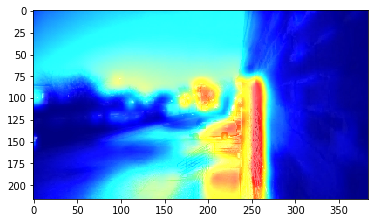

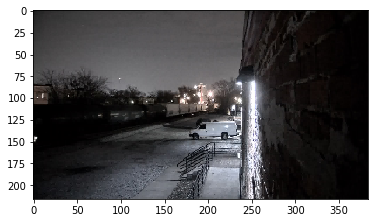

Model said train/wnx-20191118_201031_F7D8-0015.jpg did not contain a train (0.1753450632095337), but it did:


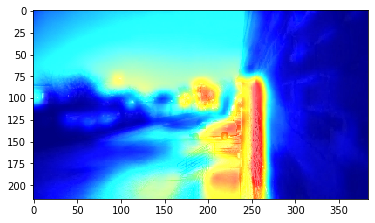

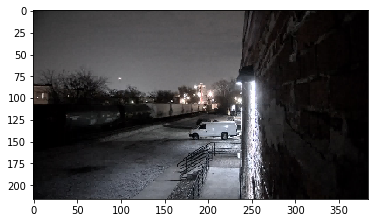

Model said train/wnx-20191118_201031_F7D8-0016.jpg did not contain a train (0.19956263899803162), but it did:


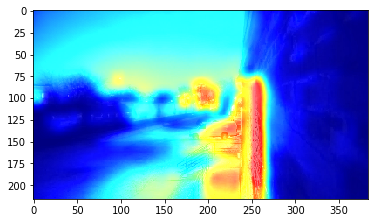

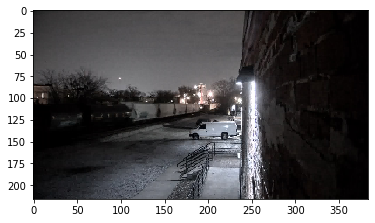

Model said train/wnx-20191118_201031_F7D8-0017.jpg did not contain a train (0.19853147864341736), but it did:


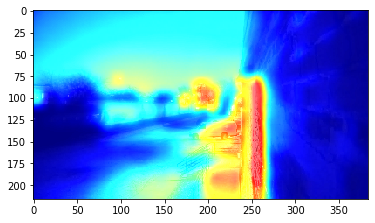

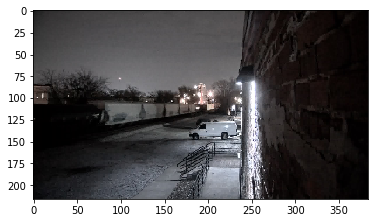

Model said train/wnx-20191118_201031_F7D8-0023.jpg did not contain a train (0.41449809074401855), but it did:


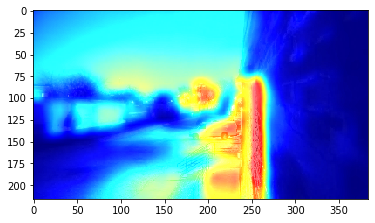

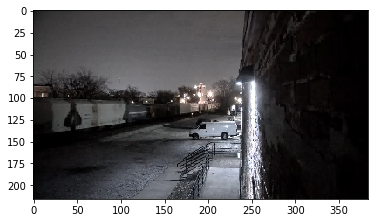

Model said train/wnx-20191118_201031_F7D8-0024.jpg did not contain a train (0.3847860097885132), but it did:


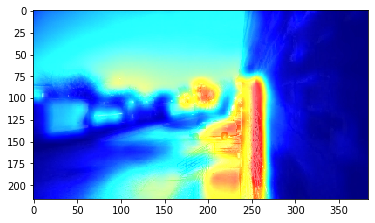

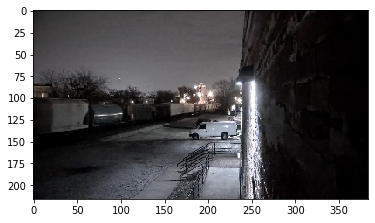

Model said train/wnx-20191118_201031_F7D8-0025.jpg did not contain a train (0.22153881192207336), but it did:


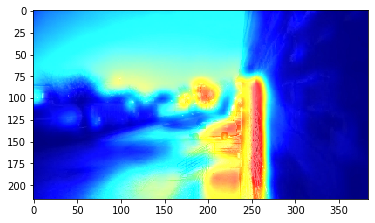

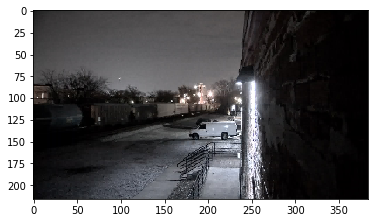

Model said train/wnx-20191118_201031_F7D8-0026.jpg did not contain a train (0.25955820083618164), but it did:


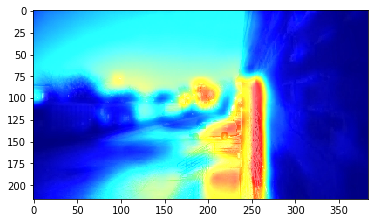

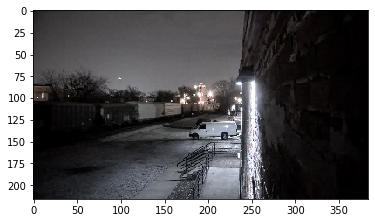

Model said train/wnx-20191118_201031_F7D8-0027.jpg did not contain a train (0.261374831199646), but it did:


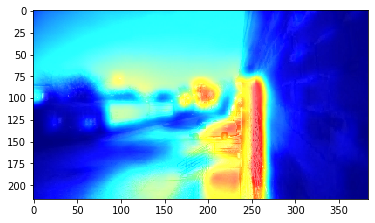

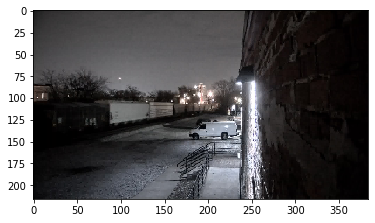

Model said train/wnx-20191118_201031_F7D8-0032.jpg did not contain a train (0.38139256834983826), but it did:


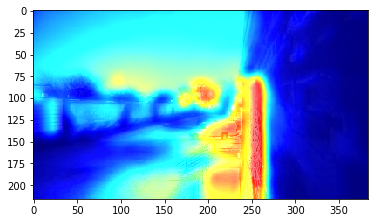

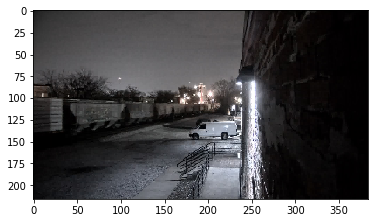

Model said train/wnx-20191118_201031_F7D8-0033.jpg did not contain a train (0.3021342158317566), but it did:


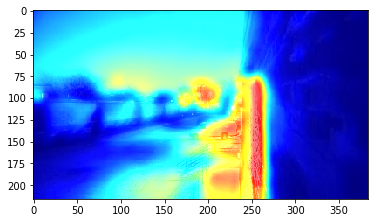

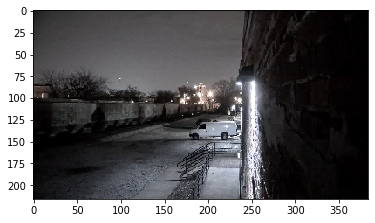

Model said train/wnx-20191118_201031_F7D8-0034.jpg did not contain a train (0.37399762868881226), but it did:


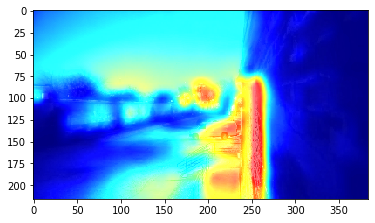

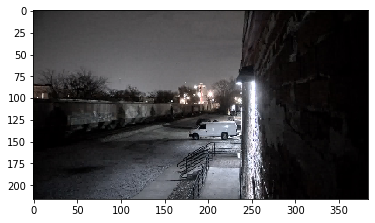

Model said train/wnx-20191118_201031_F7D8-0035.jpg did not contain a train (0.30052030086517334), but it did:


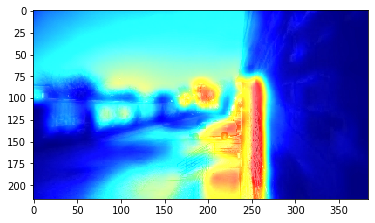

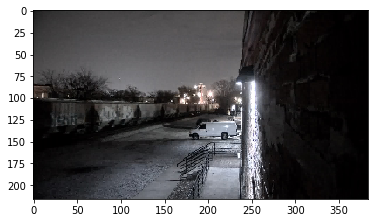

Model said train/wnx-20191118_201031_F7D8-0036.jpg did not contain a train (0.4951404631137848), but it did:


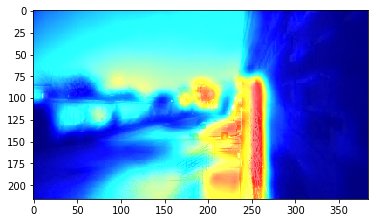

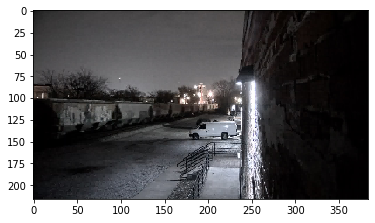

Model said train/wnx-20191118_201031_F7D8-0037.jpg did not contain a train (0.31173157691955566), but it did:


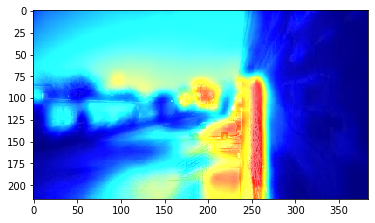

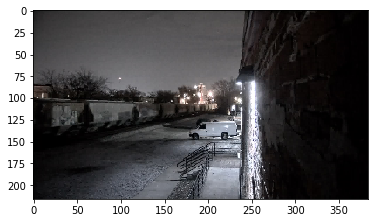

Model said train/wnx-20191118_201031_F7D8-0038.jpg did not contain a train (0.3443119525909424), but it did:


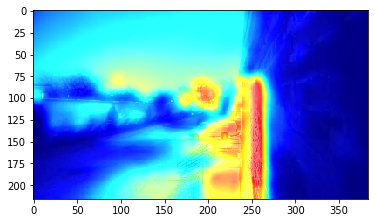

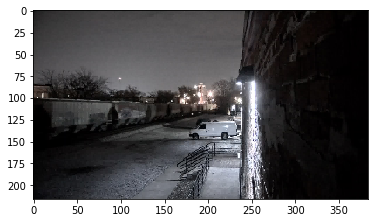

Model said train/wnx-20191118_201031_F7D8-0039.jpg did not contain a train (0.23694080114364624), but it did:


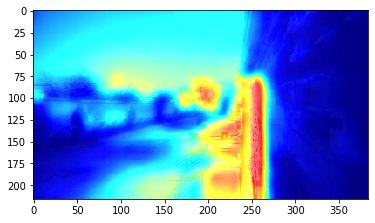

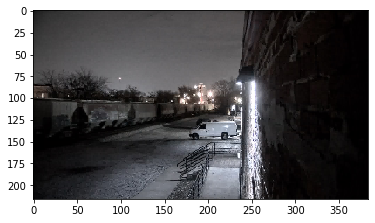

Model said train/wnx-20191118_201031_F7D8-0040.jpg did not contain a train (0.30378833413124084), but it did:


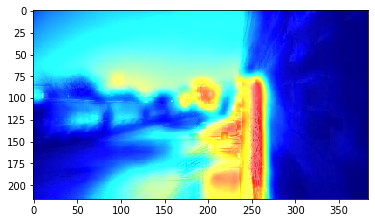

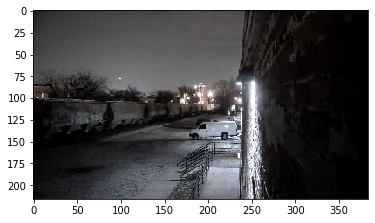

Model said train/wnx-20191118_201031_F7D8-0041.jpg did not contain a train (0.25355374813079834), but it did:


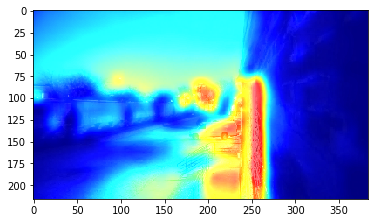

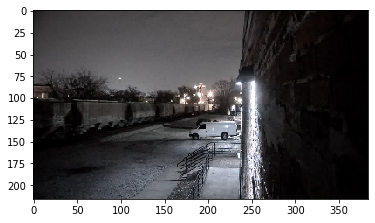

Model said train/wnx-20191118_201031_F7D8-0042.jpg did not contain a train (0.24314218759536743), but it did:


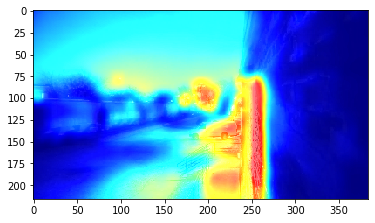

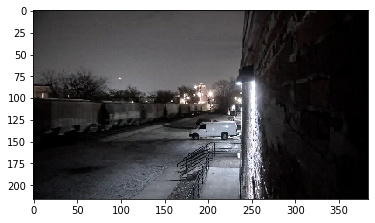

Model said train/wnx-20191118_201031_F7D8-0043.jpg did not contain a train (0.29822391271591187), but it did:


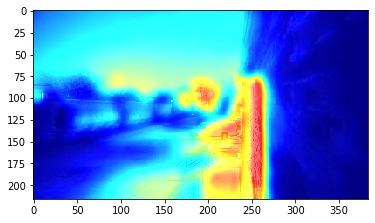

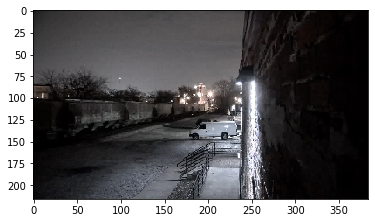

Model said train/wnx-20191118_201031_F7D8-0044.jpg did not contain a train (0.23771613836288452), but it did:


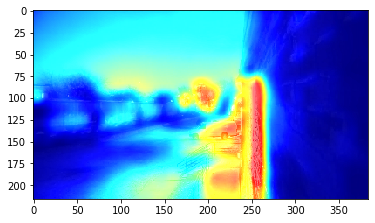

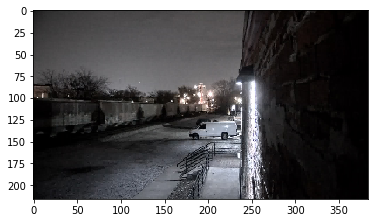

Model said train/wnx-20191118_201031_F7D8-0045.jpg did not contain a train (0.367054283618927), but it did:


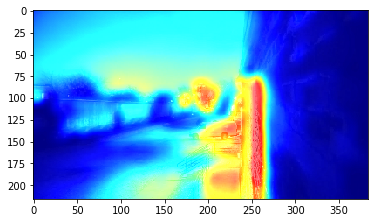

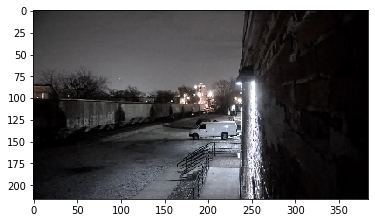

Model said train/wnx-20191118_201031_F7D8-0046.jpg did not contain a train (0.29583919048309326), but it did:


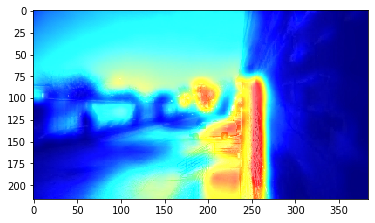

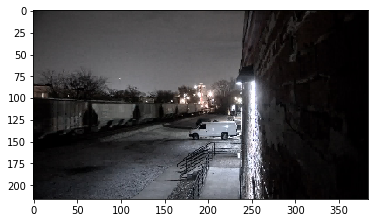

Model said train/wnx-20191118_201031_F7D8-0047.jpg did not contain a train (0.38972264528274536), but it did:


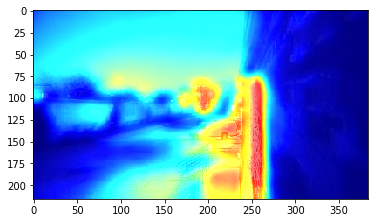

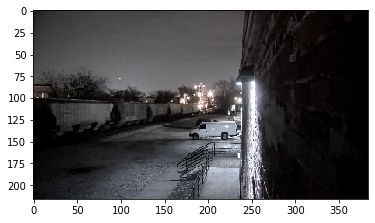

Model said train/wnx-20191118_201031_F7D8-0048.jpg did not contain a train (0.2612794041633606), but it did:


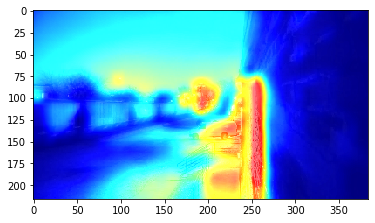

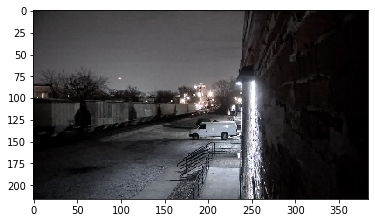

Model said train/wnx-20191118_201031_F7D8-0049.jpg did not contain a train (0.32479551434516907), but it did:


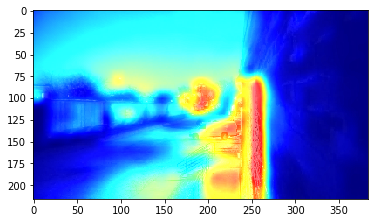

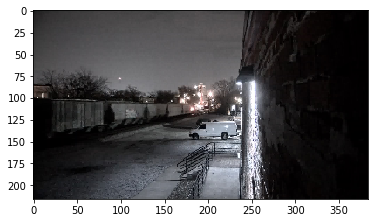

Model said train/wnx-20191118_201031_F7D8-0050.jpg did not contain a train (0.4031577706336975), but it did:


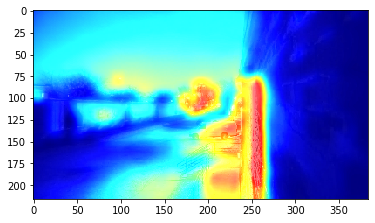

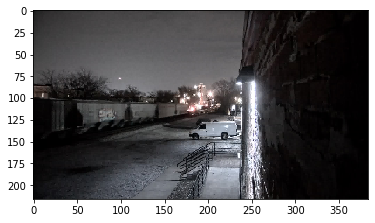

Model said train/wnx-20191118_201031_F7D8-0051.jpg did not contain a train (0.423845499753952), but it did:


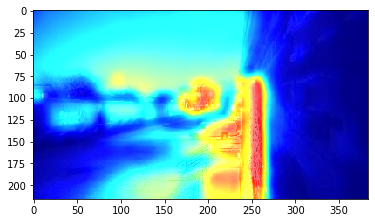

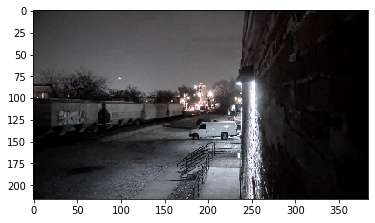

Model said train/wnx-20191118_201031_F7D8-0052.jpg did not contain a train (0.49467456340789795), but it did:


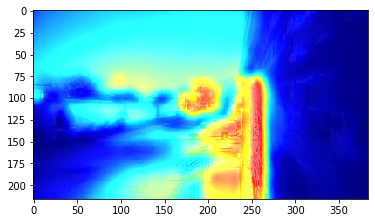

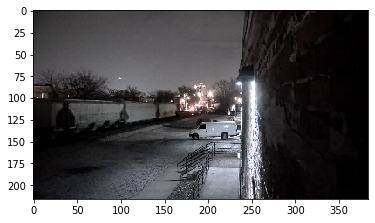

Model said train/wnx-20191118_201031_F7D8-0053.jpg did not contain a train (0.4124142527580261), but it did:


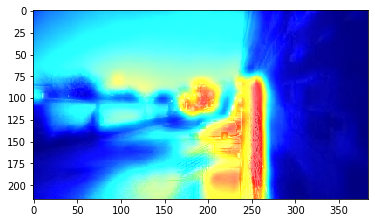

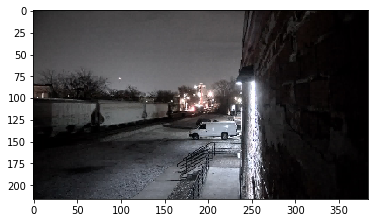

Model said train/wnx-20191118_201031_F7D8-0054.jpg did not contain a train (0.4707038104534149), but it did:


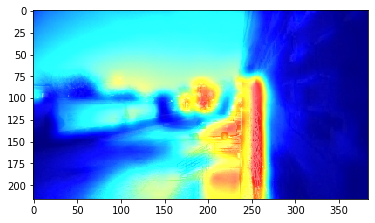

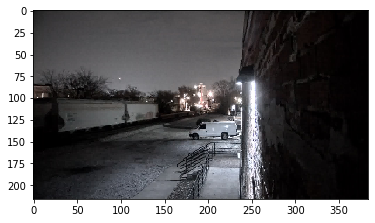

Model said train/wnx-20191118_201031_F7D8-0055.jpg did not contain a train (0.44706812500953674), but it did:


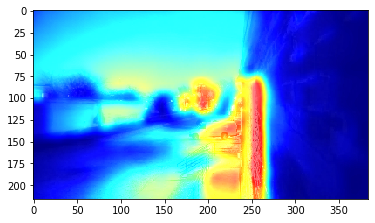

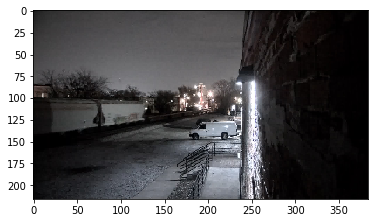

Model said train/wnx-20191118_201031_F7D8-0056.jpg did not contain a train (0.46614012122154236), but it did:


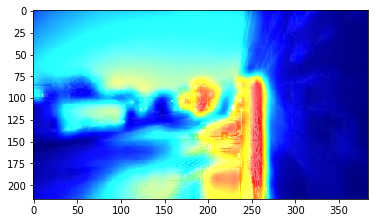

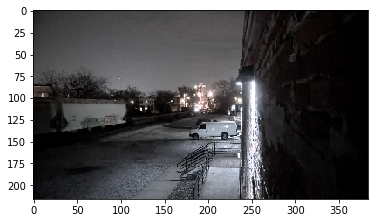

Model said train/wnx-20191118_201031_F7D8-0058.jpg did not contain a train (0.1630673110485077), but it did:


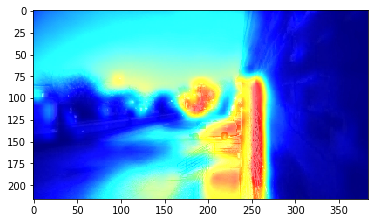

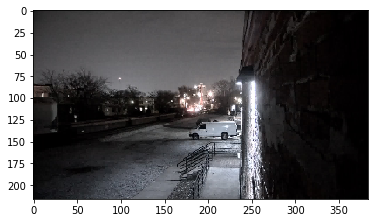

Model said train/wnx-20191118_201031_F7D8-0059.jpg did not contain a train (0.13728448748588562), but it did:


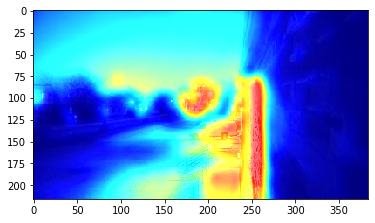

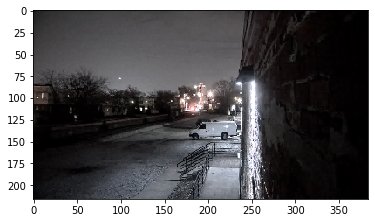

Model said train/wnx-20191118_201031_F7D8-0060.jpg did not contain a train (0.14046159386634827), but it did:


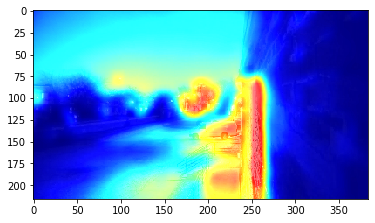

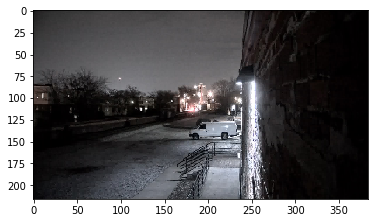

Model said train/wnx-20191118_201031_F7D8-0061.jpg did not contain a train (0.15417802333831787), but it did:


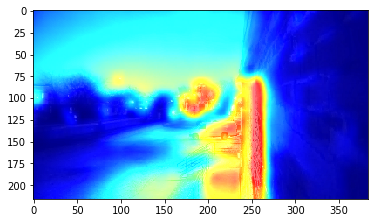

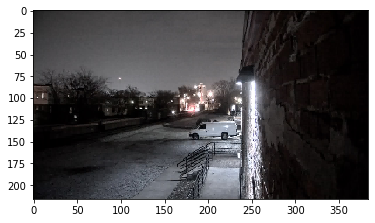

Model said train/wnx-20191118_201031_F7D8-0062.jpg did not contain a train (0.15897908806800842), but it did:


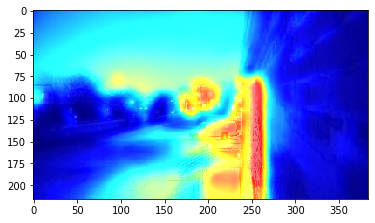

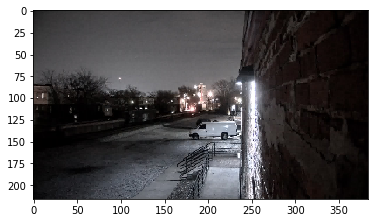

Model said train/wnx-20191118_201031_F7D8-0063.jpg did not contain a train (0.1562093198299408), but it did:


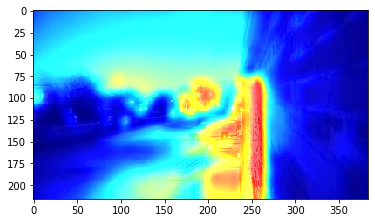

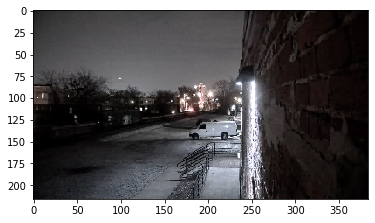

Model said train/wnx-20191118_201031_F7D8-0064.jpg did not contain a train (0.1868775486946106), but it did:


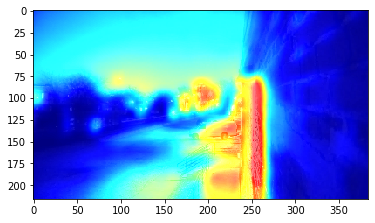

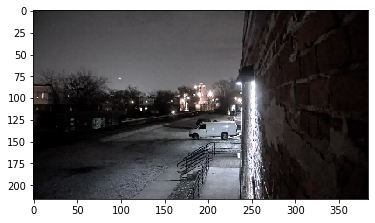

Model said train/wnx-20191118_201031_F7D8-0065.jpg did not contain a train (0.15632641315460205), but it did:


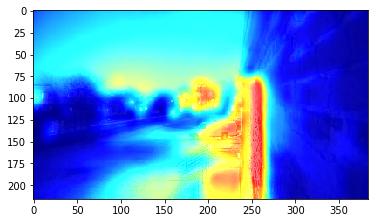

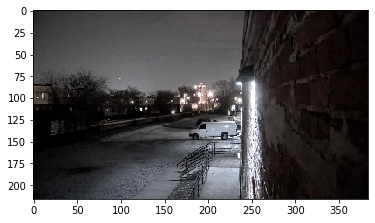

Misclassified 78 images.


In [106]:
from tensorflow.keras.models import load_model

steve_test_dir = 'data/steve_test/'
num_steve_test_samples = image_count(steve_test_dir + 'train/') + image_count(steve_test_dir + 'no_train/')

steve_test_datagen = ImageDataGenerator(rescale = 1./255)

steve_test_generator = steve_test_datagen.flow_from_directory(
        'data/steve_test/',
        target_size=(scaled_height, scaled_width),
        batch_size=batch_size,
        class_mode='binary',
        shuffle=False)

original_model = load_model('train_detection_cnn')
steve_test_y_true = steve_test_generator.classes
steve_test_y_pred = original_model.predict_generator(steve_test_generator, steps = math.ceil(num_steve_test_samples / batch_size)).flatten()
steve_test_pred_class_idxs = np.around(steve_test_y_pred)
filenames = steve_test_generator.filenames
steve_test_miss_count = 0
for i in range(num_steve_test_samples):
    if int(steve_test_pred_class_idxs[i]) != steve_test_y_true[i]:
        steve_test_miss_count += 1
        if steve_test_y_true[i] == class_idx_dict['no_train']:
            print('Model said {} contained a train ({}), but it didn\'t:'.format(filenames[i], steve_test_y_pred[i]))
        else:
            print('Model said {} did not contain a train ({}), but it did:'.format(filenames[i], steve_test_y_pred[i]))
        batch_number = i // batch_size
        img_number = i % batch_size
        img = steve_test_generator[batch_number][0][img_number]
        img_heatmap = create_grad_cam_heatmap('data/steve_test/' + filenames[i])
        plt.imshow(img_heatmap)
        plt.show()
        plt.imshow(img)
        plt.show()

print('Misclassified {} images.'.format(steve_test_miss_count))

In [105]:
steve_test_cm = confusion_matrix(steve_test_y_true, steve_test_pred_class_idxs)
print('Confusion Matrix:')
print(steve_test_cm)
true_negatives = steve_test_cm[0][0]
false_negatives = steve_test_cm[1][0]
true_positives = steve_test_cm[1][1]
false_positives = steve_test_cm[0][1]
print('True negatives: {}'.format(true_negatives))
print('False negatives: {}'.format(false_negatives))
print('True positives: {}'.format(true_positives))
print('False positives: {}'.format(false_positives))

Confusion Matrix:
[[24 22]
 [56 82]]
True negatives: 24
False negatives: 56
True positives: 82
False positives: 22
